In [1]:
import os
import sys
import tensorflow.compat.v1 as tf

sys.path.append('/shared/home/sw_innovation01/junhan/tanso/automl/efficientdet')

import hparams_config
from tf2 import anchors
from model_inspect import ModelInspector

2024-03-26 00:12:08.236699: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-26 00:12:08.236779: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-26 00:12:08.236823: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-03-26 00:12:08.249362: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-03-26 00:12:11.112662: W tensorflow/compiler/

### JSON 라벨링 방식을 TFRecord로 변경
* Annotation은 PASCAL VOC 와 비슷한 JSON 포맷

In [2]:
import json
import pandas as pd
import math

# JSON 파일을 Pandas DataFrame으로 변환 한 뒤 DataFrame의 to_csv()를 이용하여 csv 파일로 생성하고 DataFrame 반환
def get_bboxes_from_json(json_file):
    # JSON 파일을 읽고 파싱
    with open(json_file) as f:
        data = json.load(f)

    # 카테고리 ID와 이름을 매핑 (예시: {1: 'PE드럼 정상', 2: 'PE드럼 파손', ...})
    category_mapping = {category['id']: category['name'] for category in data['categories']}

    bboxes = []  # 경계 상자 정보
    bbox_names = []  # 객체 이름

    # annotations에서 각 객체 정보 추출
    for annotation in data['annotations']:
        category_id = annotation['category_id']
        bbox_name = category_mapping.get(category_id)
        bbox = annotation['bbox']
        # bbox는 [x_min, y_min, width, height] 형태로 저장됨.
        # x_min, y_min은 그대로 사용하고, width와 height를 더해 x_max, y_max 계산
        x_min = math.ceil(bbox[0])
        y_min = math.ceil(bbox[1])
        x_max = math.ceil(bbox[0] + bbox[2])
        y_max = math.ceil(bbox[1] + bbox[3])

        # x_min과 x_max가 같거나, y_min과 y_max가 같으면 무시
        if x_min == x_max or y_min == y_max:
            continue

        # 변환된 경계 상자 정보와 객체 이름 저장
        bboxes.append([x_min, y_min, x_max, y_max])
        bbox_names.append(bbox_name)

    return bbox_names, bboxes

# JSON 파일에서 정보 추출 및 출력
json_file = '/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.json'  # JSON 파일 경로 지정
bbox_names, bboxes = get_bboxes_from_json(json_file)
print('object별 class 명:', bbox_names)
print('object별 bbox 정보 list:', bboxes)


object별 class 명: ['PE입간판 파손']
object별 bbox 정보 list: [[235, 449, 637, 704]]


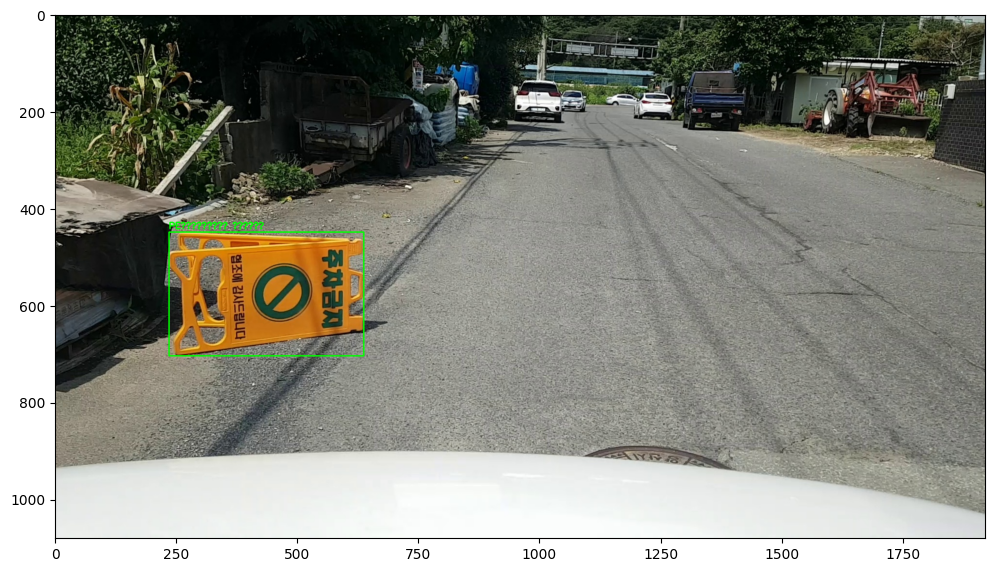

In [3]:
import matplotlib.pyplot as plt
import cv2

img_rgb = cv2.cvtColor(cv2.imread('/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg'), cv2.COLOR_BGR2RGB)

bbox_names, bboxes = get_bboxes_from_json(json_file)
for box_name, box in zip(bbox_names, bboxes):
  cv2.rectangle(img_rgb, (box[0], box[1]), (box[2], box[3]), color=(0, 255, 0), thickness=2)
  cv2.putText(img_rgb, box_name, (int(box[0]), int(box[1] - 7)), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

plt.figure(figsize=(12, 12))
plt.imshow(img_rgb)

In [4]:
import os
ANNO_DIR = '/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels'
file_list = os.listdir(ANNO_DIR)
json_files = sorted([file for file in file_list if file.endswith('.json')])
# print('json file list:', json_files)
print('json file 개수:', len(json_files))

json file 개수: 2914


### 개별 XML 정보와 이미지를 tf.train.Example로 변경하는 함수 생성. 
* https://github.com/google/automl/blob/master/efficientdet/dataset/create_pascal_tfrecord.py 참조

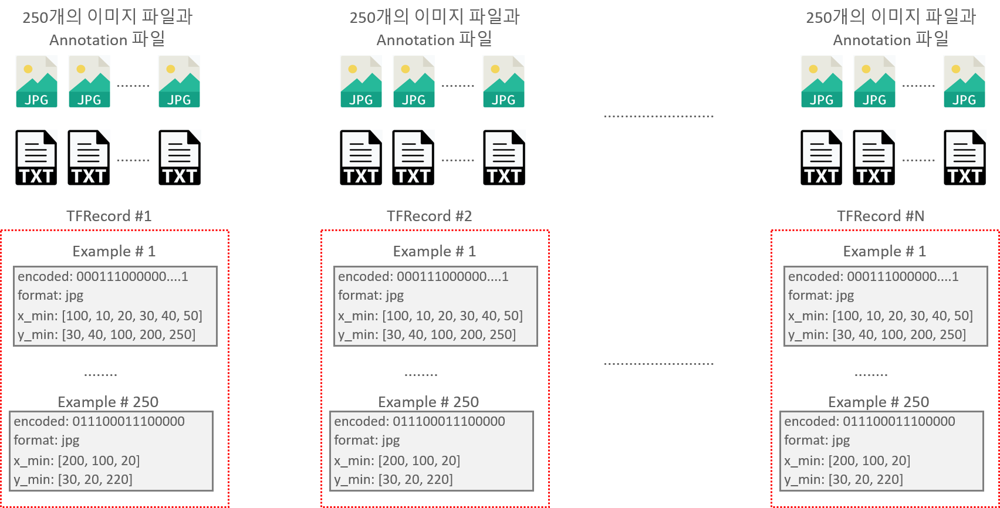

In [5]:
import json
import math

# JSON 파일을 파싱해서 image와 object의 메타정보를 dict로 반환하는 함수
def get_anno_dict_from_json(json_filepath):
    with open(json_filepath) as f:
        data = json.load(f)

    # 이미지 메타데이터 추출
    image_info = data['images'][0]  # 예시에서는 하나의 이미지 정보만 포함되어 있음
    filename = image_info['file_name']
    width = image_info['width']
    height = image_info['height']

    # 카테고리 ID와 이름을 매핑
    category_mapping = {category['id']: category['name'] for category in data['categories']}
    
    objects = []

    # 각 객체 정보 추출
    for annotation in data['annotations']:
        category_id = annotation['category_id']
        name = category_mapping.get(category_id)

        bbox = annotation['bbox']
        # JSON에서는 bbox가 [xmin, ymin, width, height] 형태로 주어짐
        xmin = math.ceil(bbox[0])
        ymin = math.ceil(bbox[1])
        xmax = math.ceil(xmin + bbox[2])  # width를 더함
        ymax = math.ceil(ymin + bbox[3])  # height를 더함

        bndbox = {
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        }

        # 다른 메타데이터는 XML 예제와의 호환성을 위해 기본값으로 설정
        single_obj = {
            'name': name,
            'pose': 'Unspecified',
            'truncated': 0,
            'difficult': 0,
            'occluded': 0,
            'bndbox': bndbox
        }
        objects.append(single_obj)

    anno_dict = {
        'folder': 'training_data',
        'filename': filename,
        'width': width,
        'height': height,
        'object': objects
    }

    return anno_dict

In [6]:
anno_dict = get_anno_dict_from_json(json_file)
anno_dict

{'folder': 'training_data',
 'filename': 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg',
 'width': 1920,
 'height': 1080,
 'object': [{'name': 'PE입간판 파손',
   'pose': 'Unspecified',
   'truncated': 0,
   'difficult': 0,
   'occluded': 0,
   'bndbox': {'xmin': 235, 'ymin': 449, 'xmax': 638, 'ymax': 704}}]}

In [7]:
# image와 object의 고유 id 부여. 
class Unique_Id(object):
  
  def __init__(self):
    self.image_id = 0
    self.ann_id = 0

  def get_image_id(self):
    self.image_id += 1
    return self.image_id

  def get_ann_id(self):
    self.ann_id += 1
    return self.ann_id


In [8]:
# https://github.com/google/automl/blob/master/efficientdet/dataset/create_pascal_tfrecord.py 참조

import hashlib
import io
import json
import os
import PIL.Image
import tensorflow as tf
from dataset import tfrecord_util

# 1개의 image 파일 PATH와 1개의 annotation json 정보를 가지는 data dic를 이용하여 tf.train.Example를 생성. 
def dict_to_tf_example(data, image_path, label_map_dict, unique_id, ignore_difficult_instances=False, ann_json_dict=None, debug=True):
  ''' 
    data는  1개의 json 파일을 dictionary로 변환 anno_dict,
    image는 1개의 json에 매핑되는 image 파일의 절대 경로
    unique_id는 고유한 image와 object id를 만들기 위한 Unique_Id객체
  ''' 
  
  #JPEG image를 binary 그대로 읽음. 
  with tf.io.gfile.GFile(image_path, 'rb') as fid:
    encoded_jpg = fid.read()
  
  # image가 JPEG 타입인지 확인. 
  encoded_jpg_io = io.BytesIO(encoded_jpg)
  image = PIL.Image.open(encoded_jpg_io)
  if image.format != 'JPEG':
    raise ValueError('Image format not JPEG')
  
  # image의 고유 key값 생성. 
  key = hashlib.sha256(encoded_jpg).hexdigest()

  #고유한 image id를 생성. 
  image_id = unique_id.get_image_id()
  # image의 width와 height 가져옴. 
  width = data['width']
  height = data['height']
 
  xmins, ymins, xmaxes, ymaxes = [], [], [], []
  areas, classes, classes_texts = [], [], []
  truncated, poses, difficult_obj = [], [], []
  # 만일 annotation에 1개 이상의 object가 있다면, 
  if 'object' in data:
    # data(anno_dict)의 'object' key값으로 개별 object 별 annotation 정보를 dict로 가지는 list로 구성. 이 list를 iteration 수행. 
    for obj in data['object']:
      difficult = bool(int(obj['difficult']))
      if ignore_difficult_instances and difficult:
        continue
      # object 명이 '1', '2'가 아니면 제외. 
      if obj['name'] not in label_map_dict:
        continue

      difficult_obj.append(int(difficult))
      # 개별 좌표 값을 이미지의 크기로 정규화하고 list로 저장. 
      xmins.append(float(obj['bndbox']['xmin']) / width)
      ymins.append(float(obj['bndbox']['ymin']) / height)
      xmaxes.append(float(obj['bndbox']['xmax']) / width)
      ymaxes.append(float(obj['bndbox']['ymax']) / height)
      areas.append((xmaxes[-1] - xmins[-1]) * (ymaxes[-1] - ymins[-1]))
      # class명과 class_id를 list로 저장. 
      classes_texts.append(obj['name'].encode('utf8'))
      classes.append(label_map_dict[obj['name']])
      # truncated, poses, difficult_obj는 사용되지 않지만 create_pascal_voc.py 파일과의 호환성을 유지하기 위해 저장. 
      truncated.append(int(obj['truncated']))
      poses.append(obj['pose'].encode('utf8'))
      difficult_obj.append(obj['difficult'])

  example_dict = {'height':height, 'width':width, 'filename':data['filename'].encode('utf8'),
                  'source_id': str(image_id).encode('utf8'), 'key_sha256': key.encode('utf8'),
                  'encoded': encoded_jpg, 'format':'jpeg'.encode('utf8'),
                  'xmin':xmins, 'xmax':xmaxes, 'ymin':ymins, 'ymax':ymaxes,
                  'area':areas, 'class_text':classes_texts, 'class_label':classes,
                  'difficult':difficult_obj, 'truncated':truncated, 'poses':poses}
  if debug:
   print('example_dict:', example_dict) 

  example = make_tfrecord_example(example_dict)

  return example

In [9]:
import tensorflow as tf
from dataset import tfrecord_util

# 인자로 들어온 dict에 따라 tf.train.Example을 생성. 
def make_tfrecord_example(example_dict):
  example = tf.train.Example(
        features=tf.train.Features(
            feature={
                'image/height': tfrecord_util.int64_feature(example_dict['height']),
                'image/width': tfrecord_util.int64_feature(example_dict['width']),
                'image/filename': tfrecord_util.bytes_feature(example_dict['filename']),
                'image/source_id': tfrecord_util.bytes_feature(example_dict['source_id']),
                'image/key/sha256': tfrecord_util.bytes_feature(example_dict['key_sha256']),
                'image/encoded': tfrecord_util.bytes_feature(example_dict['encoded']),
                'image/format': tfrecord_util.bytes_feature('jpeg'.encode('utf8')),
                'image/object/bbox/xmin': tfrecord_util.float_list_feature(example_dict['xmin']),
                'image/object/bbox/xmax': tfrecord_util.float_list_feature(example_dict['xmax']),
                'image/object/bbox/ymin': tfrecord_util.float_list_feature(example_dict['ymin']),
                'image/object/bbox/ymax': tfrecord_util.float_list_feature(example_dict['ymax']),
                'image/object/area': tfrecord_util.float_list_feature(example_dict['area']),
                'image/object/class/text': tfrecord_util.bytes_list_feature(example_dict['class_text']),
                'image/object/class/label': tfrecord_util.int64_list_feature(example_dict['class_label']),
                'image/object/difficult': tfrecord_util.int64_list_feature(example_dict['difficult']),
                'image/object/truncated': tfrecord_util.int64_list_feature(example_dict['truncated']),
                'image/object/view': tfrecord_util.bytes_list_feature(example_dict['poses']),
            }))
  
  return example


In [10]:
label_map_dict = {
    'PE드럼 정상': 1, 'PE드럼 파손': 2, 'PE방호벽 정상': 3, 'PE방호벽 파손': 4, 'PE안내봉 정상': 5, 'PE안내봉 파손': 6, '라바콘 정상': 7, '라바콘 파손': 8,
    '시선유도봉 정상': 9, '시선유도봉 파손': 10, '제설함 정상': 11, '제설함 파손': 12, 'PE입간판 정상': 13, 'PE입간판 파손': 14, 'PE휀스 정상': 15, 'PE휀스 파손': 16
}

# 테스트 용도로 한개의 Example 생성해 보기 
unique_id = Unique_Id()
data = get_anno_dict_from_json(json_file)
print('## json 파일을 data dic로 변경 결과:', data)
image_path = '/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg'

example = dict_to_tf_example(data, image_path, label_map_dict, unique_id, ignore_difficult_instances=False, ann_json_dict=None)

## json 파일을 data dic로 변경 결과: {'folder': 'training_data', 'filename': 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg', 'width': 1920, 'height': 1080, 'object': [{'name': 'PE입간판 파손', 'pose': 'Unspecified', 'truncated': 0, 'difficult': 0, 'occluded': 0, 'bndbox': {'xmin': 235, 'ymin': 449, 'xmax': 638, 'ymax': 704}}]}
example_dict: {'height': 1080, 'width': 1920, 'filename': b'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg', 'source_id': b'1', 'key_sha256': b'f9d8b55ac6fbfc229c64c7e3e90b9c72bd4714566c5709f491aeea95fce8aae8', 'encoded': b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x02\x01\x01\x01\x01\x01\x02\x01\x01\x01\x02\x02\x02\x02\x02\x04\x03\x02\x02\x02\x02\x05\x04\x04\x03\x04\x06\x05\x06\x06\x06\x05\x06\x06\x06\x07\t\x08\x06\x07\t\x07\x06\x06\x08\x0b\x08\t\n\n\n\n\n\x06\x08\x0b\x0c\x0b\n\x0c\t\n\n\n\xff\xdb\x00C\x01\x02\x02\x02\x02\x02\x02\x05\x03\x03\x05\n\x07\x06\x07\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n\n

In [11]:
example

features {
  feature {
    key: "image/width"
    value {
      int64_list {
        value: 1920
      }
    }
  }
  feature {
    key: "image/source_id"
    value {
      bytes_list {
        value: "1"
      }
    }
  }
  feature {
    key: "image/object/view"
    value {
      bytes_list {
        value: "Unspecified"
      }
    }
  }
  feature {
    key: "image/object/truncated"
    value {
      int64_list {
        value: 0
      }
    }
  }
  feature {
    key: "image/object/difficult"
    value {
      int64_list {
        value: 0
        value: 0
      }
    }
  }
  feature {
    key: "image/object/class/text"
    value {
      bytes_list {
        value: "PE\354\236\205\352\260\204\355\214\220 \355\214\214\354\206\220"
      }
    }
  }
  feature {
    key: "image/object/class/label"
    value {
      int64_list {
        value: 14
      }
    }
  }
  feature {
    key: "image/object/bbox/ymin"
    value {
      float_list {
        value: 0.415740728
      }
    }
  }
  fe

### 학습과 검증용 TFRecord 파일들을 생성. 
* 학습과 검증용 DataFrame으로 학습, 검증 데이터세트 분류
* 개별 Example을 생성하는 dict_to_tf_example()을 이용하여 모든 데이터 세트를 TFRecord로 생성. 

In [12]:
file_id_list = sorted([json_file[:json_file.rfind('.json')] for json_file in os.listdir('/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels') \
                if '.json' in json_file])
print(file_id_list)
len(file_id_list)

['reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00461', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00462', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00464', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00465', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00466', 'reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00468', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00095', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00096', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00097', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00098', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00099', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00100', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00101', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00103', 'reproduce_sunny_AM_20221020_112802_sedan_Gijang-gun_00104', 'reproduce_sunny_AM_202

2914

In [13]:
import pandas as pd

pd.set_option('display.max_colwidth', 300)
data_df = pd.DataFrame({'file_id': file_id_list})
data_df['image_path'] = '/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/' + data_df['file_id'] + '.jpg'
data_df['json_path'] = '/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/' + data_df['file_id'] + '.json'

print(data_df.shape)
data_df.head()

(2914, 3)


,file_id,image_path,json_path
0,reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.jpg,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00460.json
1,reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00461,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00461.jpg,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00461.json
2,reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00462,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00462.jpg,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00462.json
3,reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00464,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00464.jpg,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00464.json
4,reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00465,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00465.jpg,/shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/labels/reproduce_sunny_AM_20221020_112229_sedan_Yangsan-si_00465.json


In [14]:
from sklearn.model_selection import train_test_split

# 전체 데이터의 20%를 검증용으로 할당.
train_df, val_df = train_test_split(data_df, test_size=0.2, random_state=2021)
print(train_df.shape, val_df.shape)

(2331, 3) (583, 3)


In [15]:
# 모든 image/xml 파일들을 TFRecord로 생성. 
def make_tfrecords(meta_df, output_dir, output_prefix, num_shards):
  '''
  meta_df: train/val DataFrame에서 입력 xml과 image의 경로를 가져옴. 
  output_dir: 출력 TFRecord가 저장될 directory
  output_prefix: 출력 TFRecord 파일의 prefix명. 
  num_shards: 만들어질 TFRecord 파일의 수
  '''
  json_list = meta_df['json_path'].to_list()
  image_list = meta_df['image_path'].to_list()

  unique_id = Unique_Id()
  # num_shards 만큼의 TFRecordWriter객체 생성. 
  writers = [
        tf.io.TFRecordWriter(output_dir + output_prefix +'-%05d-of-%05d.tfrecord' %
                            (i, num_shards))
        for i in range(num_shards)
    ]
  #xml 개수만큼 iteration을 돌려서 Example을 만들고 개별 Example을 특정 shard에 해당하는 TFRecord에 append
  for idx, json_path in enumerate(json_list):
    if idx % 100 == 0:
      print('On image ', idx, 'of ', len(json_list))
    
    data = get_anno_dict_from_json(json_path)
    image_path = image_list[idx]
    # 개별 Example 생성. 
    tf_example = dict_to_tf_example(data, image_path, label_map_dict, unique_id, 
                                    ignore_difficult_instances=False, ann_json_dict=None, debug=False)
    # num_shard만큼 만들어진 TFRecord에 Example을 iteration을 수행하면서 해당하는 TFRecord로 append 
    writers[idx % num_shards].write(tf_example.SerializeToString())
  
  # num_shards 만큼 만들어진 TFRecordWriter 객체 close
  for writer in writers:
    writer.close()

In [ ]:
!mkdir -p /shared/home/sw_innovation01/junhan/tanso/tfrecord/train
!mkdir -p /shared/home/sw_innovation01/junhan/tanso/tfrecord/val

In [17]:
print('#### train용 tfrecords 생성 시작 ####')
make_tfrecords(train_df, '/shared/home/sw_innovation01/junhan/tanso/tfrecord/train/', 'train', num_shards=100)

print('#### val용 tfrecords 생성 시작 ####')
make_tfrecords(val_df, '/shared/home/sw_innovation01/junhan/tanso/tfrecord/val/', 'val', num_shards=100)

#### train용 tfrecords 생성 시작 ####
On image  0 of  2331
On image  100 of  2331
On image  200 of  2331
On image  300 of  2331
On image  400 of  2331
On image  500 of  2331
On image  600 of  2331
On image  700 of  2331
On image  800 of  2331
On image  900 of  2331
On image  1000 of  2331
On image  1100 of  2331
On image  1200 of  2331
On image  1300 of  2331
On image  1400 of  2331
On image  1500 of  2331
On image  1600 of  2331
On image  1700 of  2331
On image  1800 of  2331
On image  1900 of  2331
On image  2000 of  2331
On image  2100 of  2331
On image  2200 of  2331
On image  2300 of  2331
#### val용 tfrecords 생성 시작 ####
On image  0 of  583
On image  100 of  583
On image  200 of  583
On image  300 of  583
On image  400 of  583
On image  500 of  583


In [16]:
!ls -lia /shared/home/sw_innovation01/junhan/tanso/tfrecord/train
!ls -lia /shared/home/sw_innovation01/junhan/tanso/tfrecord/val

total 1393584
353403098 drwxrwxr-x 2 sw_innovation01 sw_innovation01     4096 Mar 26  2024 .
353403096 drwxrwxr-x 4 sw_innovation01 sw_innovation01     4096 Mar 26  2024 ..
353403198 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14356262 Mar 26  2024 train-00000-of-00100.tfrecord
353403199 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14025877 Mar 26  2024 train-00001-of-00100.tfrecord
353403200 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14977483 Mar 26  2024 train-00002-of-00100.tfrecord
353403201 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 15166958 Mar 26  2024 train-00003-of-00100.tfrecord
353403202 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 15368263 Mar 26  2024 train-00004-of-00100.tfrecord
353403203 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14238463 Mar 26  2024 train-00005-of-00100.tfrecord
353403204 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14328820 Mar 26  2024 train-00006-of-00100.tfrecord
353403205 -rw-rw-r-- 1 sw_innovation01 sw_innovation01 14457079 Mar 26  2024 t

### Pretrained 모델을 다운로드 받고 Train을 위한 config 생성
* pretrained 모델은 efficientdet-d2
* num_classes는 2, max_instances_per_image는 기본 100개임. 1개의 이미지에  특정 object의 갯수가 100개를 초과하는 경우가 있음.  max_instances_per_image = 200 으로 수정. 

In [17]:
import os, sys 
!mkdir -p /shared/home/sw_innovation01/junhan/tanso/model_trained_d2

In [18]:
MODEL = 'efficientdet-d2' 

def download(m):
  if m not in os.listdir():
    !wget https://storage.googleapis.com/cloud-tpu-checkpoints/efficientdet/coco/{m}.tar.gz
    !tar zxf {m}.tar.gz
  ckpt_path = os.path.join(os.getcwd(), m)
  return ckpt_path

# Download checkpoint.
ckpt_path = download(MODEL)
print('Use model in {}'.format(ckpt_path))

Use model in /shared/home/sw_innovation01/junhan/tanso/efficientdet-d2


In [19]:
class TRAIN_CFG:
  model_name = 'efficientdet-d2' # efficientdet 모델명
  strategy = '' # tpu, 여러개의 GPU들, 단일 GPU 일때 학습 strategy 설정. 
  model_dir = '/shared/home/sw_innovation01/junhan/tanso/model_trained_d2' # 학습된 모델이 저장될 위치
  pretrained_ckpt = '/shared/home/sw_innovation01/junhan/tanso/efficientdet-d2' # coco로 pretrained된 checkpoint 파일이 있는 디렉토리 위치
  # num_classes는 16개임. 
  hparams = 'num_classes=16,moving_average_decay=0,mixed_precision=true'
  use_xla = False
  use_fake_data = False
  # max_instances_per_image를 200으로 설정하고, D2 모델이 상대적으로 더 크기 때문에 batch_size를 8로 설정시 GPU Out of Memory 발생 
  batch_size = 4
  eval_samples = 5000 # evaluation image 데이터 갯수
  steps_per_execution = 1 # train 시 steps 횟수
  num_examples_per_epoch = 3000 # 1 epochs 시 적용하는 examples 개수 
  num_epochs = 20 # epochs 횟수
  train_file_pattern = '/shared/home/sw_innovation01/junhan/tanso/tfrecord/train/train-*.tfrecord' # 학습용 tfrecords를 glob 형태로 가져오는 표현식. 
  val_file_pattern = '/shared/home/sw_innovation01/junhan/tanso/tfrecord/val/val-*.tfrecord' # 검증용 tfrecords를 glob 형태로 가져오는 표현식. 
  val_json_file = None # optional coco validation json 
  mode = 'traineval' # train만 적용 또는 train과 eval함께 적용(traineval)
  num_shards = 100 # 
  # max_instances_per_image는 기본 100개임. 1개의 이미지에  특정 object의 갯수가 100개를 초과하는 경우가 있음. 200으로 수정. 
  max_instances_per_image = 200
  
  num_cores = 2 # tpu 일때 8 적용.  
  tpu = None
  gcp_project = None
  tpu_zone = None
  eval_master = ''
  eval_name = None
  tf_random_seed = 2021
  profile = False
  debug = False

In [20]:
# 강의영상에는 from keras import anchors 이지만 efficientdet 패키지의 keras 모듈이 tf2 로 변경됨.
from tf2.train import setup_model
import hparams_config

import utils
from tf2 import tfmot
from tf2 import train_lib
from tf2 import util_keras

config = hparams_config.get_detection_config(TRAIN_CFG.model_name)
config.override(TRAIN_CFG.hparams)

steps_per_epoch = TRAIN_CFG.num_examples_per_epoch // TRAIN_CFG.batch_size

if tf.config.list_physical_devices('GPU'):
  ds_strategy = tf.distribute.OneDeviceStrategy('device:GPU:0')
else:
  ds_strategy = tf.distribute.OneDeviceStrategy('device:CPU:0')

print(ds_strategy)

params = dict(
      profile=TRAIN_CFG.profile,
      mode = TRAIN_CFG.mode,
      model_name=TRAIN_CFG.model_name,
      steps_per_execution=TRAIN_CFG.steps_per_execution,
      num_epochs = TRAIN_CFG.num_epochs,
      model_dir=TRAIN_CFG.model_dir,
      steps_per_epoch=steps_per_epoch,
      strategy=TRAIN_CFG.strategy,
      batch_size=TRAIN_CFG.batch_size,
      tf_random_seed=TRAIN_CFG.tf_random_seed,
      debug=TRAIN_CFG.debug,
      val_json_file=TRAIN_CFG.val_json_file,
      eval_samples=TRAIN_CFG.eval_samples,
      num_shards=ds_strategy.num_replicas_in_sync,
      # max_instances_per_image는 기본 100개임. 1개의 이미지에  특정 object의 갯수가 100개를 초과하는 경우가 있음. 200으로 수정.
      max_instances_per_image = TRAIN_CFG.max_instances_per_image
      )

config.override(params, True)

# image size를 tuple 형태로 변환. 512는 (512, 512)로 '1920x880' 은 (1920, 880) 으로 변환.  
config.image_size = utils.parse_image_size(config.image_size)
print(config)

act_type: swish
alpha: 0.25
anchor_scale: 4.0
apply_bn_for_resampling: true
aspect_ratios:
- 1.0
- 2.0
- 0.5
autoaugment_policy: null
backbone_config: null
backbone_name: efficientnet-b2
batch_size: 4
box_class_repeats: 3
box_loss_weight: 50.0
ckpt_var_scope: null
clip_gradients_norm: 10.0
conv_after_downsample: false
conv_bn_act_pattern: false
data_format: channels_last
dataset_type: null
debug: false
delta: 0.1
drop_remainder: true
eval_samples: 5000
first_lr_drop_epoch: 200.0
fpn_cell_repeats: 5
fpn_config: null
fpn_name: null
fpn_num_filters: 112
fpn_weight_method: null
gamma: 1.5
grad_checkpoint: false
grid_mask: false
heads:
- object_detection
image_size: !!python/tuple
- 768
- 768
img_summary_steps: null
input_rand_hflip: true
iou_loss_type: null
iou_loss_weight: 1.0
is_training_bn: true
jitter_max: 2.0
jitter_min: 0.1
label_map: null
label_smoothing: 0.0
learning_rate: 0.08
loss_scale: null
lr_decay_method: cosine
lr_warmup_epoch: 1.0
lr_warmup_init: 0.008
map_freq: 5
max_insta

2024-03-26 00:14:45.149705: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1886] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43500 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:01:00.0, compute capability: 8.6


In [21]:
import utils
from tf2 import tfmot
from tf2 import train_lib
from tf2 import util_keras
# P100에서는 적용할 필요 없음. 
'''
precision = utils.get_precision(config.strategy, config.mixed_precision)
policy = tf.keras.mixed_precision.Policy(precision)
tf.keras.mixed_precision.set_global_policy(policy)
'''

'\nprecision = utils.get_precision(config.strategy, config.mixed_precision)\npolicy = tf.keras.mixed_precision.Policy(precision)\ntf.keras.mixed_precision.set_global_policy(policy)\n'

### Dataset과 Model 생성하고 학습 수행. 
* 앞에서 만든 train과 val용 TFRecord를 이용하여 dataloader.InputReader를 생성하는 함수 생성.
* efficientdet-d2 모델 생성 후 pretrained 모델의 weight 전이.
* batch_size 4로 설정. 8로 설정 시 GPU Memory OOM 발생 가능성 높음(Out Of Memory), epochs 20으로 학습 수행. 

In [22]:
import dataloader

def get_dataset(is_training, config):
  # is_training이 True이면 TRAIN_CFG의 train_file_pattern, 그렇지 아니면 val_file_pattern
  file_pattern = (
    TRAIN_CFG.train_file_pattern
    if is_training else TRAIN_CFG.val_file_pattern)
  if not file_pattern:
    raise ValueError('No matching files.')

  return dataloader.InputReader(
    file_pattern,
    is_training=is_training,
    use_fake_data=TRAIN_CFG.use_fake_data,
    max_instances_per_image=config.max_instances_per_image,
    debug=TRAIN_CFG.debug)(
        config.as_dict())

In [23]:
from tf2 import train_lib
from tf2 import train

def get_efficientdet_model(config):
  # 2개의 class를 가진 efficientdet d2 모델을 생성. 
  model = train_lib.EfficientDetNetTrain(config=config)
  model = train.setup_model(model, config)
  # 만약 pretrained 모델이 있으면, 해당 checkpoint weight를 모델로 로딩. 이때 classification layer는 제외. 
  #class TRAIN_CFG: pretrained_ckpt = '/content/efficientdet-d2' 
  if TRAIN_CFG.pretrained_ckpt:
    ckpt_path = tf.train.latest_checkpoint(TRAIN_CFG.pretrained_ckpt)
    # classfication layer를 제외하고 pretrained weight를 생성된 모델로 로딩. 
    util_keras.restore_ckpt(
        model,
        ckpt_path,
        config.moving_average_decay,
        exclude_layers=['class_net'])
    
  train.init_experimental(config)
  return model

model = get_efficientdet_model(config)
model.summary()

/tmp/__autograph_generated_file20h377_l.py:23: UserWarning: `layer.updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  ag__.for_stmt(ag__.ld(self).updates, None, loop_body, get_state, set_state, (), {'iterate_names': 'u'})


Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.NEAREST_NEIGHBOR...)` instead.


Instructions for updating:
Use `tf.image.resize(...method=ResizeMethod.NEAREST_NEIGHBOR...)` instead.
/shared/home/sw_innovation01/junhan/tanso/automl/efficientdet/utils.py:255: UserWarning: `layer.updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  for u in self.updates:


Model: ""
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnet-b2 (Model)     multiple                  7267314   
                                                                 
 resample_p6 (ResampleFeatu  multiple                  39984     
 reMap)                                                          
                                                                 
 resample_p7 (ResampleFeatu  multiple                  0         
 reMap)                                                          
                                                                 
 fpn_cells (FPNCells)        multiple                  678479    
                                                                 
 class_net (ClassNet)        multiple                  64992     
                                                                 
 box_net (BoxNet)            multiple                  52788     


In [24]:
print(config.mode)

traineval


In [26]:
from tf2 import train
import numpy as np

config.batch_size = 4
tr_steps_per_epoch = train_df.shape[0]//config.batch_size
val_steps_per_epoch = val_df.shape[0]//config.batch_size
print('tr_steps_per_epoch:', tr_steps_per_epoch, 'val_steps_per_epoch:', val_steps_per_epoch)

val_dataset = get_dataset(False, config) if 'eval' in config.mode else None
model.fit(
    get_dataset(True, config),
    epochs=20,
    steps_per_epoch=tr_steps_per_epoch,
    callbacks=train_lib.get_callbacks(config.as_dict(), val_dataset),
    validation_data=val_dataset,
    validation_steps=val_steps_per_epoch)

tf.keras.backend.clear_session()

tr_steps_per_epoch: 582 val_steps_per_epoch: 145
Epoch 1/20


2024-03-26 00:17:16.163944: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8700
2024-03-26 00:17:26.520164: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fb64a14b770 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-03-26 00:17:26.520222: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA A40, Compute Capability 8.6
2024-03-26 00:17:26.626521: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


  6/582 [..............................] - ETA: 3:43 - det_loss: 4358.3906 - cls_loss: 4358.1750 - box_loss: 0.0043 - reg_l2_loss: 0.0972 - loss: 4358.4878 - learning_rate: 0.0080 - gradient_norm: 10.0000WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.3715s vs `on_train_batch_end` time: 0.4444s). Check your callbacks.


582/582 [==============================] - ETA: 0s - det_loss: 62.9042 - cls_loss: 62.8308 - box_loss: 0.0015 - reg_l2_loss: 0.0974 - loss: 63.0016 - learning_rate: 0.0068 - gradient_norm: 2.8818
Epoch 1: saving model to /shared/home/sw_innovation01/junhan/tanso/model_trained_d2/ckpt-1
582/582 [==============================] - 394s 412ms/step - det_loss: 62.7966 - cls_loss: 62.7233 - box_loss: 0.0015 - reg_l2_loss: 0.0974 - loss: 62.8939 - learning_rate: 0.0068 - gradient_norm: 2.8796 - val_det_loss: 0.1051 - val_cls_loss: 0.0892 - val_box_loss: 3.1800e-04 - val_reg_l2_loss: 0.0974 - val_loss: 0.2025
Epoch 2/20
582/582 [==============================] - ETA: 0s - det_loss: 0.1810 - cls_loss: 0.1454 - box_loss: 7.1179e-04 - reg_l2_loss: 0.0974 - loss: 0.2783 - learning_rate: 0.0051 - gradient_norm: 1.8511
Epoch 2: saving model to /shared/home/sw_innovation01/junhan/tanso/model_trained_d2/ckpt-2
582/582 [==============================] - 232s 398ms/step - det_loss: 0.1808 - cls_loss: 0.

AttributeError: module 'numpy' has no attribute 'float'.
`np.float` was a deprecated alias for the builtin `float`. To avoid this error in existing code, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

### 학습된 모델 파일을 이용하여 Inference 수행.

In [27]:
import sys

sys.path.append('/shared/home/sw_innovation01/junhan/tanso/automl/efficientdet')

In [28]:
import hparams_config

infer_config = hparams_config.get_efficientdet_config('efficientdet-d2')

# config의 특정 항목을 update
infer_config.model_name = 'efficientdet-d2'
infer_config.model_dir = '/shared/home/sw_innovation01/junhan/tanso/model_trained_d2'
# infer_config의 num_classes는 2로 바뀌어야 함. 
infer_config.num_classes = 16
infer_config.is_training_bn = False
infer_config.nms_configs.score_thresh = 0.4

print(infer_config)

act_type: swish
alpha: 0.25
anchor_scale: 4.0
apply_bn_for_resampling: true
aspect_ratios:
- 1.0
- 2.0
- 0.5
autoaugment_policy: null
backbone_config: null
backbone_name: efficientnet-b2
box_class_repeats: 3
box_loss_weight: 50.0
ckpt_var_scope: null
clip_gradients_norm: 10.0
conv_after_downsample: false
conv_bn_act_pattern: false
data_format: channels_last
dataset_type: null
delta: 0.1
drop_remainder: true
first_lr_drop_epoch: 200.0
fpn_cell_repeats: 5
fpn_config: null
fpn_name: null
fpn_num_filters: 112
fpn_weight_method: null
gamma: 1.5
grad_checkpoint: false
grid_mask: false
heads:
- object_detection
image_size: 768
img_summary_steps: null
input_rand_hflip: true
iou_loss_type: null
iou_loss_weight: 1.0
is_training_bn: false
jitter_max: 2.0
jitter_min: 0.1
label_map: null
label_smoothing: 0.0
learning_rate: 0.08
loss_scale: null
lr_decay_method: cosine
lr_warmup_epoch: 1.0
lr_warmup_init: 0.008
map_freq: 5
max_instances_per_image: 100
max_level: 7
mean_rgb:
- 123.675
- 116.28
- 103.

In [29]:
import inference
from tf2 import efficientdet_keras
import tensorflow as tf

model = efficientdet_keras.EfficientDetModel(config=infer_config)
model.build((None, None, None, 3))
print('#### checkpoint name:', tf.train.latest_checkpoint(infer_config.model_dir))
model.load_weights(tf.train.latest_checkpoint(infer_config.model_dir))
model.summary()

#### checkpoint name: /shared/home/sw_innovation01/junhan/tanso/model_trained_d2/ckpt-5
Model: ""
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnet-b2 (Model)     multiple                  7267314   
                                                                 
 resample_p6 (ResampleFeatu  multiple                  39984     
 reMap)                                                          
                                                                 
 resample_p7 (ResampleFeatu  multiple                  0         
 reMap)                                                          
                                                                 
 fpn_cells (FPNCells)        multiple                  678479    
                                                                 
 class_net (ClassNet)        multiple                  64992     
                                            

In [30]:
import time

class ExportModel(tf.Module):

  def __init__(self, model):
    super().__init__()
    self.model = model

  @tf.function
  def f(self, imgs):
    #model(imgs, training=False, post_mode='global')
    return self.model(imgs, training=False, post_mode='global')

export_model = ExportModel(model)

In [31]:
labels_to_names =  {1:'1', 2:'2', 3:'3', 4:'4', 5:'5', 6:'6', 7:'7', 8:'8', 9:'9', 10:'10',
                    11:'11', 12:'12', 13:'13', 14:'14', 15:'15', 16:'16'}

In [44]:
def get_detected_img(export_model, img_array, is_print=True):   
  # automl efficent은 반환 bbox 좌표값이 원본 이미지 좌표값으로 되어 있으므로 별도의 scaling작업 필요 없음. 
  '''
  height = img_array.shape[0]
  width = img_array.shape[1]
  '''
  # cv2의 rectangle()은 인자로 들어온 이미지 배열에 직접 사각형을 업데이트 하므로 그림 표현을 위한 별도의 이미지 배열 생성. 
  draw_img = img_array.copy()

  # bounding box의 테두리와 caption 글자색 지정
  green_color=(0, 255, 0)
  red_color=(255, 0, 0)

  # cv2로 만들어진 numpy image array를 tensor로 변환
  img_tensor = tf.convert_to_tensor(img_array, dtype=tf.uint8)[tf.newaxis, ...]
  #img_tensor = tf.convert_to_tensor(img_array, dtype=tf.float32)[tf.newaxis, ...]

  # efficientdet 모델을 다운로드 한 뒤 inference 수행. 
  start_time = time.time()
  # automl efficientdet 모델은 boxes, score, classes, num_detections를 각각 Tensor로 반환. 
  boxes, scores, classes, valid_len = export_model.f(img_tensor)
  # Tensor값을 시각화를 위해 numpy 로 변환. 
  boxes = boxes.numpy()
  scores = scores.numpy()
  classes = classes.numpy()
  valid_len = valid_len.numpy()
  
  # detected 된 object들을 iteration 하면서 정보 추출. detect된 object의 갯수는 100개
  for i in range(valid_len[0]):
    # detection score를 iteration시 마다 높은 순으로 추출하고 SCORE_THRESHOLD보다 낮으면 loop 중단. 
    score = scores[0, i]
    
    # detected된 object들은 scale된 기준으로 예측되었으므로 다시 원본 이미지 비율로 계산
    box = boxes[0, i]

    ''' **** 주의 ******
    box는 ymin, xmin, ymax, xmax 순서로 되어 있음. 또한 원본 좌표값으로 되어 있음. '''
    left = box[1]
    top = box[0] 
    right = box[3] 
    bottom = box[2] 

    # class id 추출하고 class 명으로 매핑
    class_id = classes[0, i]
    caption = "{}: {:.4f}".format(labels_to_names[class_id], score)
    print(caption)
    #cv2.rectangle()은 인자로 들어온 draw_img에 사각형을 그림. 위치 인자는 반드시 정수형.
    cv2.rectangle(draw_img, (int(left), int(top)), (int(right), int(bottom)), color=green_color, thickness=2)
    cv2.putText(draw_img, caption, (int(left), int(top - 5)), cv2.FONT_HERSHEY_SIMPLEX, 0.9, red_color, 2)

  if is_print:
    print('Detection 수행시간:',round(time.time() - start_time, 2),"초")

  return draw_img

In [59]:
from sklearn.model_selection import train_test_split

# 전체 데이터의 20%를 검증용으로 할당.
_, test_df = train_test_split(val_df, test_size=0.03, random_state=2021)
print(_.shape, test_df.shape)

(565, 3) (18, 3)


In [60]:
test_df['image_path']

1288      /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_wet_AM_20221013_111549_sedan_Gijang-gun_01233.jpg
299     /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_sunny_AM_20221020_114306_sedan_Gijang-gun_00854.jpg
1414      /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_wet_AM_20221013_111549_sedan_Gijang-gun_01399.jpg
2833        /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_wet_AM_20221020_112216_sedan_Ulsan-si_00365.jpg
577       /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_wet_AM_20221006_111549_sedan_Gijang-gun_00923.jpg
1674        /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/images/reproduce_wet_AM_20221013_112216_sedan_Ulsan-si_01655.jpg
1837        /shared/home/sw_innovation01/junhan/tanso/data/training_data/training_data/i

7: 0.9988
7: 0.7703
Detection 수행시간: 0.04 초
13: 0.6762
Detection 수행시간: 0.03 초
7: 0.9976
Detection 수행시간: 0.03 초
7: 0.9994
7: 0.9963
7: 0.7891
Detection 수행시간: 0.03 초
7: 0.9990
Detection 수행시간: 0.03 초
7: 0.9993
7: 0.9924
7: 0.6862
Detection 수행시간: 0.03 초
7: 0.9988
7: 0.9985
7: 0.7801
Detection 수행시간: 0.03 초
7: 0.9892
Detection 수행시간: 0.03 초
7: 0.9983
7: 0.9939
Detection 수행시간: 0.03 초
7: 0.8911
Detection 수행시간: 0.03 초
7: 0.9980
7: 0.9912
Detection 수행시간: 0.03 초
7: 0.9934
Detection 수행시간: 0.03 초
10: 0.6075
Detection 수행시간: 0.03 초
7: 0.9977
7: 0.9834
Detection 수행시간: 0.03 초
7: 0.9989
7: 0.7978
Detection 수행시간: 0.03 초
7: 0.9979
7: 0.8661
7: 0.8036
Detection 수행시간: 0.03 초
10: 0.6233
Detection 수행시간: 0.03 초
7: 0.9944
7: 0.6270
Detection 수행시간: 0.03 초


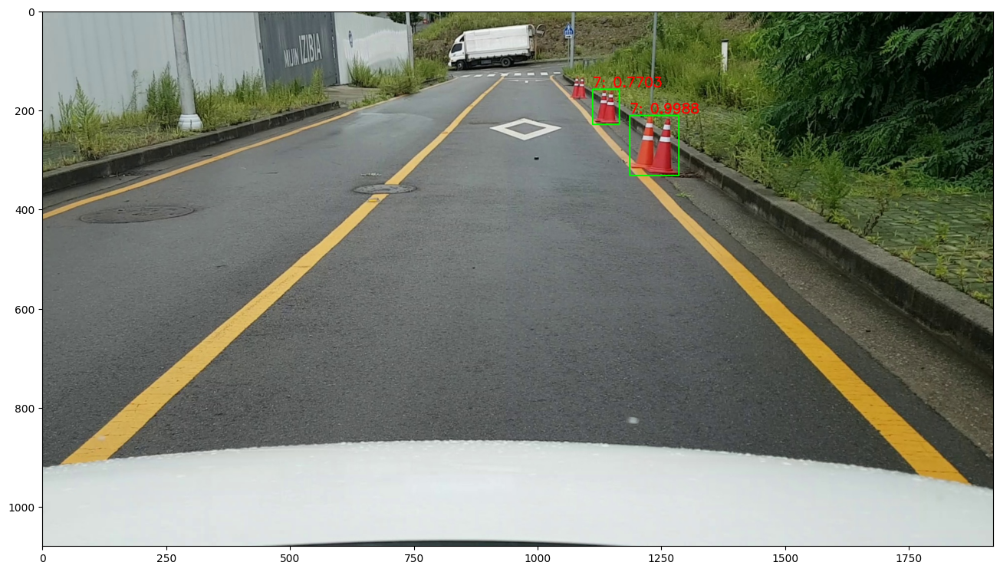

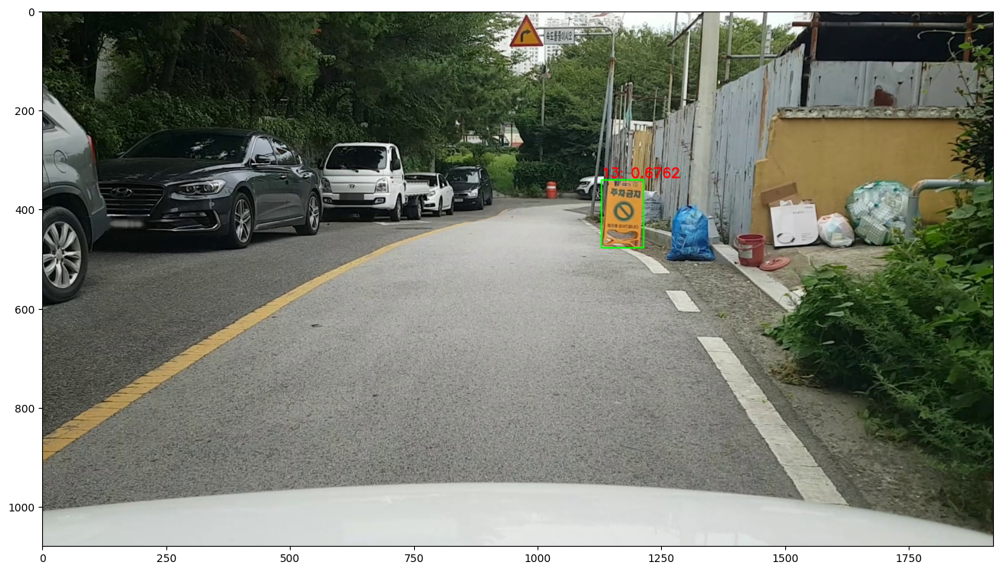

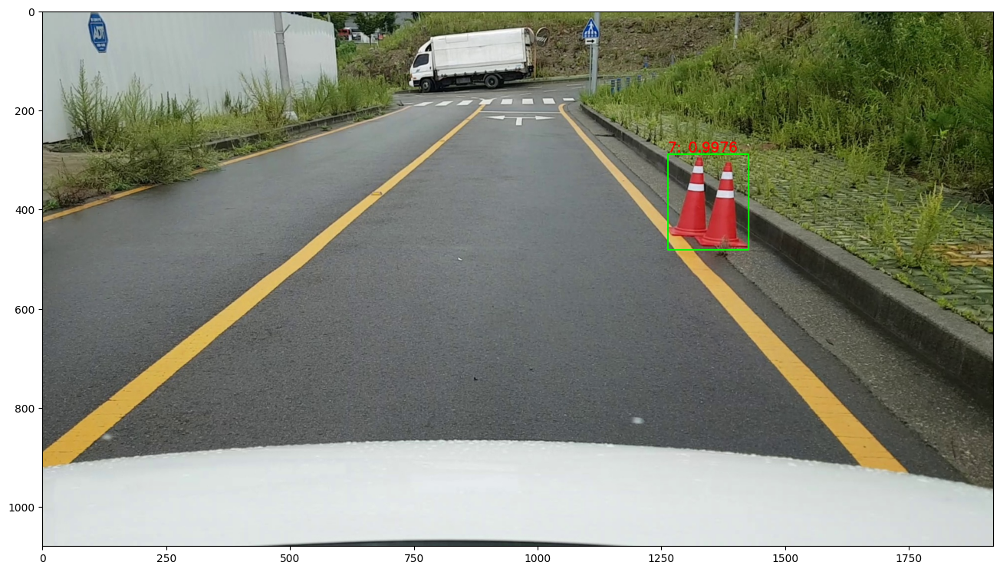

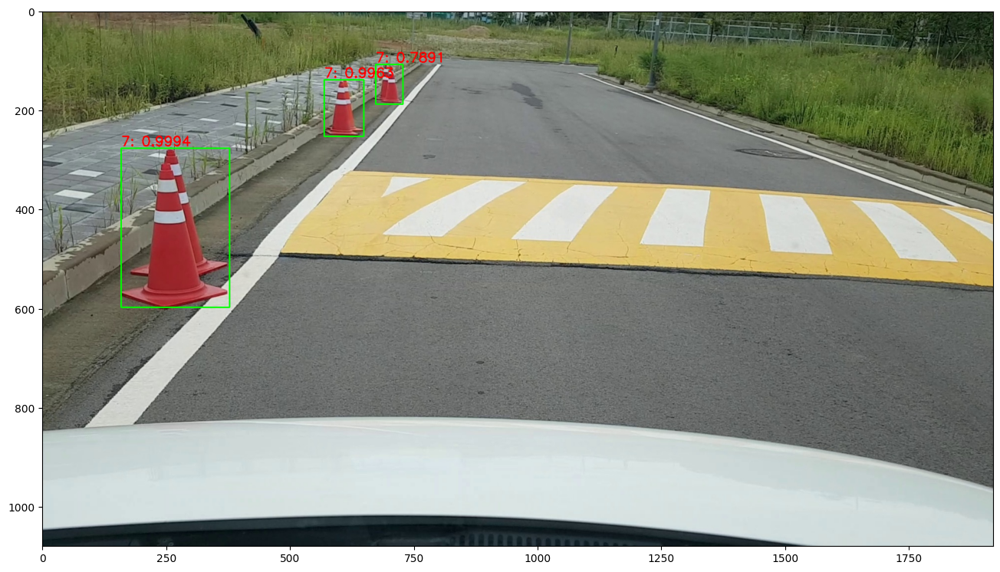

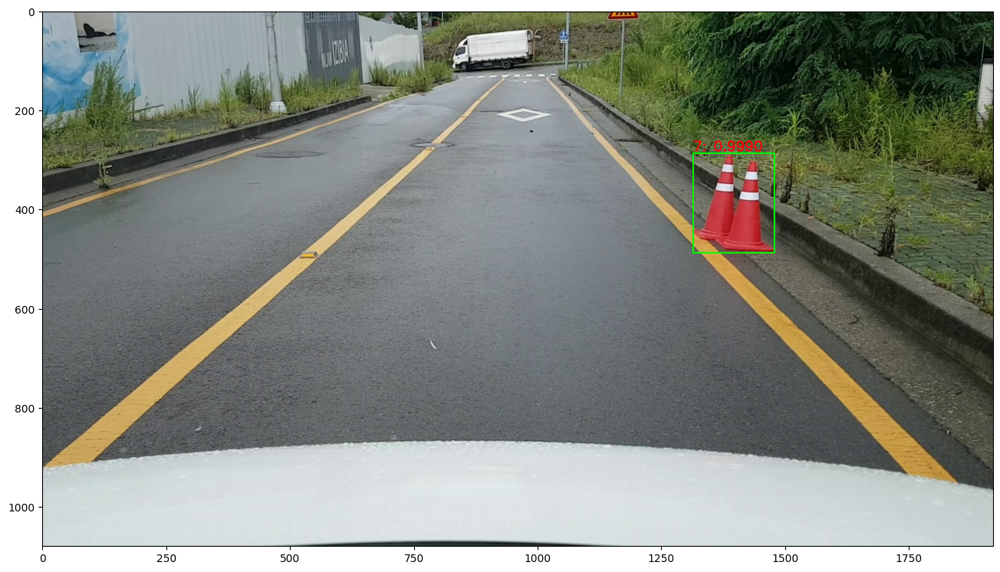

...

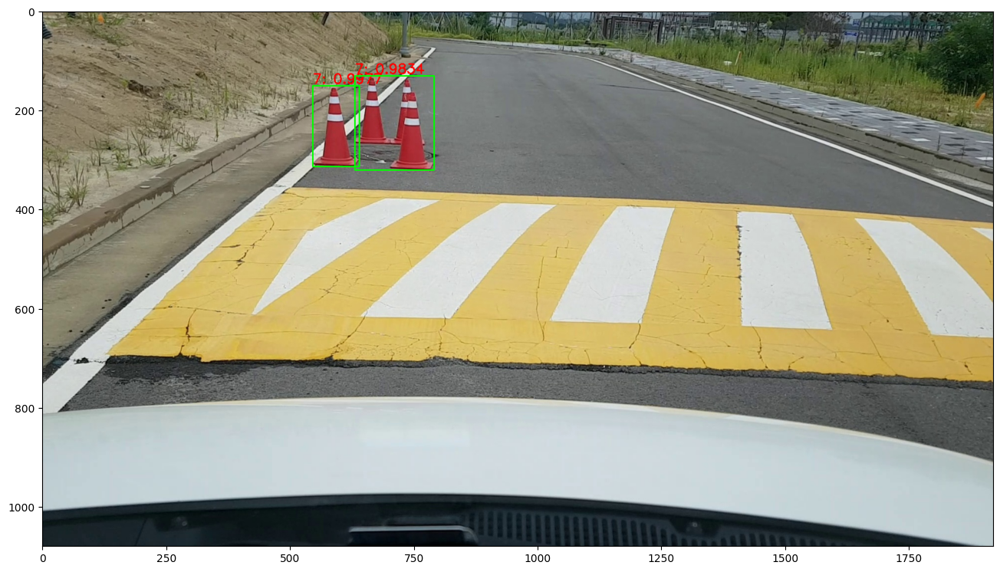

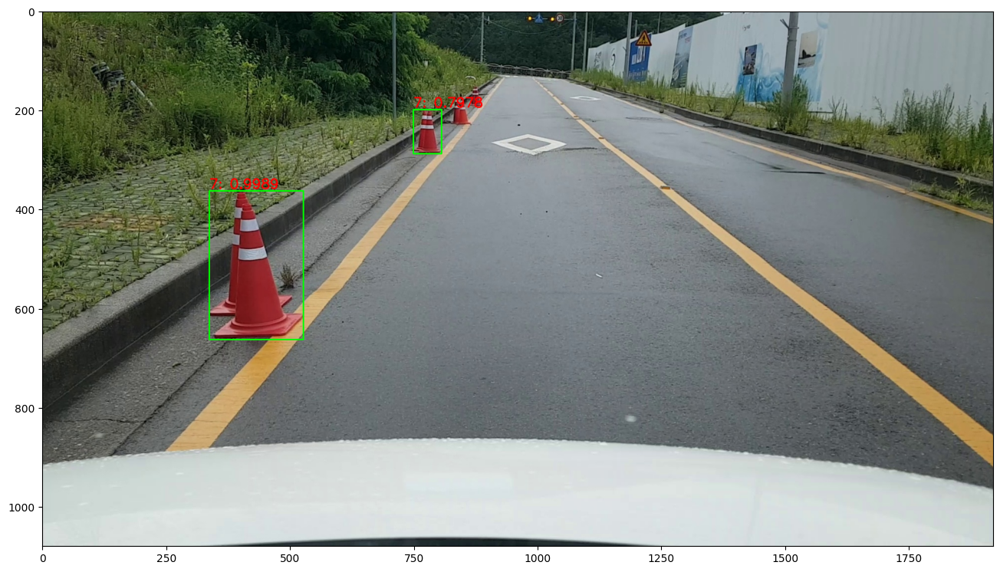

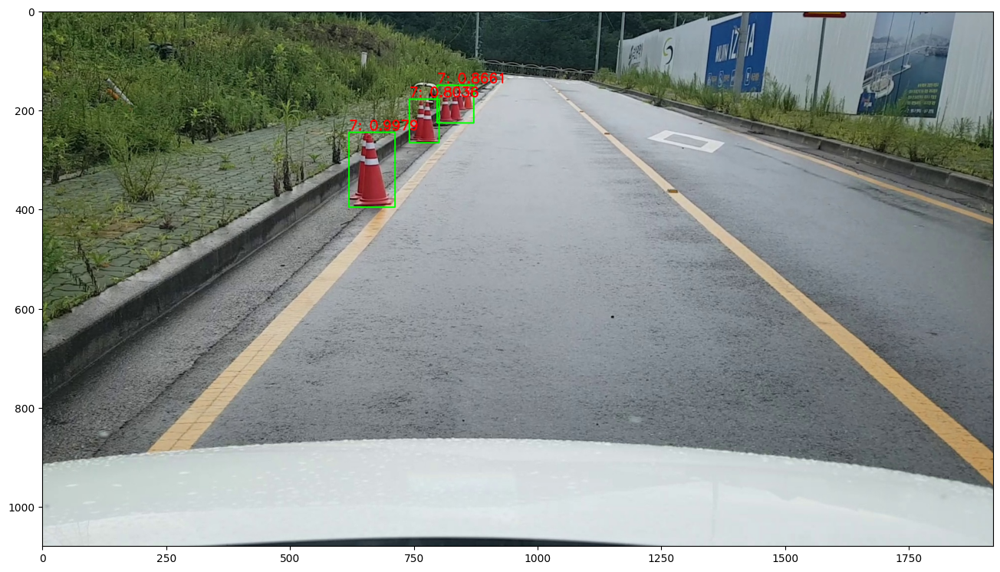

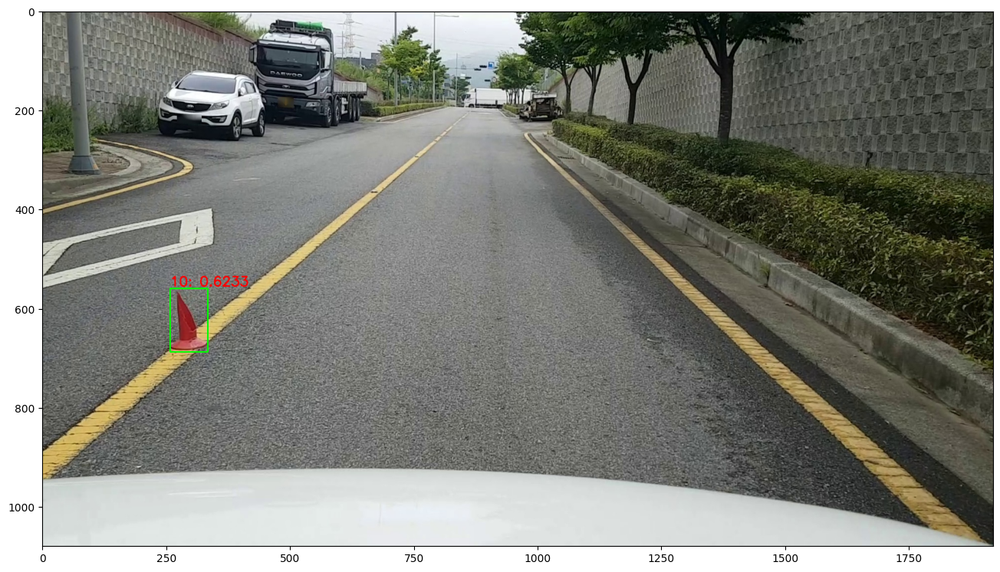

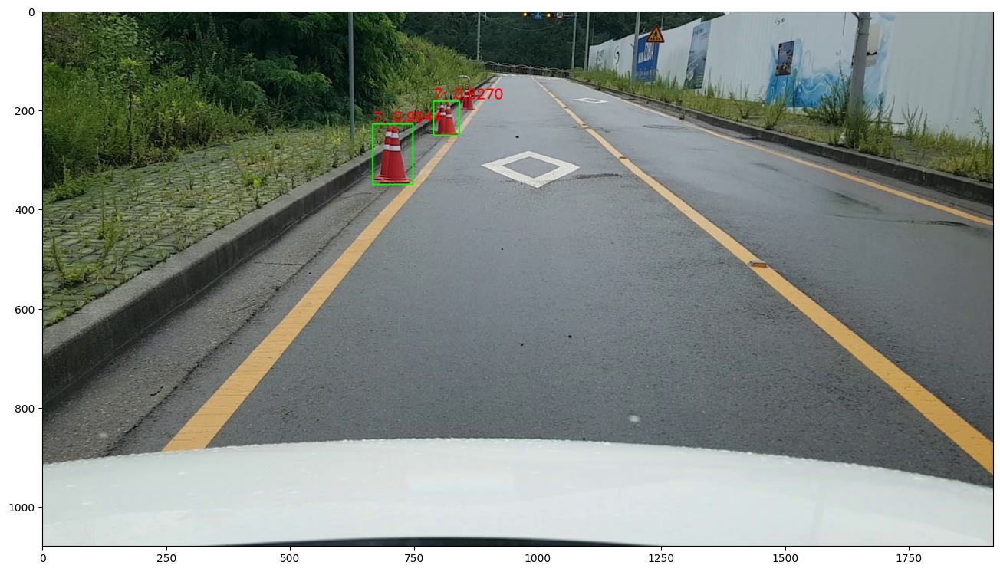

In [61]:
import cv2
import matplotlib.pyplot as plt

for image_path in test_df['image_path']:
    img_array = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

    draw_img = get_detected_img(export_model, img_array, is_print=True)
    plt.figure(figsize=(16, 16))
    plt.imshow(draw_img)